## E16-14. 프로젝트 : SRGAN 활용하기
앞에서 사용했던 SRGAN 구조를 이용해 프로젝트를 수행해 봅시다. 

### 프로젝트 1 : 직접 고른 이미지로 SRGAN 실험하기
---

이제 여러분이 직접 다른 이미지를 사용해 볼 차례입니다.

앞서 사용했던 DIV2K 데이터셋은 bicubic interpolation을 이용해 가로 및 세로 픽셀 수를 1/4로 줄인 저해상도 이미지와 원래 고해상도 이미지 사이에서 학습되었습니다. 이 데이터셋으로 학습된 SRGAN를 이용해 좋은 결과를 얻기 위해서는 위와 같은 과정이 동일하게 진행되는 것이 좋습니다.

아래와 같이 두 가지 다른 단계를 거쳐서 직접 고른 이미지에 대해 SRGAN을 적용해 봅시다. (모델 학습을 진행하는 건 아닙니다.) 테스트할 이미지를 고를 때, DIV2K 의 학습 데이터셋과 비슷한 종류의 이미지가 좋습니다. 일반적으로 자연, 동물, 건물 등의 이미지가 학습에 사용되었으며, 이와 달리 애니메이션 등의 이미지는 고해상도로 잘 변환되지 않을 수 있습니다.

특정 데이터셋에서만 학습되었기 때문에, 일반적으로 좋지 않은 결과가 나올 가능성이 높습니다. 결과와 상관없이 아래 과정만 잘 수행해봅시다.

In [1]:
import tensorflow as tf
import tensorflow_datasets as tfds

In [2]:
tfds.load("div2k/bicubic_x4")

train, valid = tfds.load(
    'div2k/bicubic_x4',
    split=["train", "validation"],
    as_supervised=True
)

def preprocessing(lr, hr):
    hr = tf.cast(hr, tf.float32) /255.
    hr_patch = tf.image.random_crop(hr, size=[96, 96, 3])
    lr_patch = tf.image.resize(hr_patch, [96//4, 96//4],
                              "bicubic")
    return lr_patch, hr_patch

train = train.map(preprocessing).shuffle(buffer_size=10).repeat().batch(8)
valid = valid.map(preprocessing).repeat().batch(8)

In [3]:
from tensorflow.keras import Input, Model

def gene_base_block(x):
    out = layers.Conv2D(64, 3, 1, "same")(x)
    out = layers.BatchNormalization()(out)
    out = layers.PReLU(shared_axes=[1,2])(out)
    out = layers.Conv2D(64, 3, 1, "same")(out)
    out = layers.BatchNormalization()(out)
    return layers.Add()([x, out])

def upsample_block(x):
    out = layers.Conv2D(256, 3, 1, "same")(x)
    out = layers.Lambda(lambda x:tf.nn.depth_to_space(x,2))(out)
    return layers.PReLU(shared_axes=[1,2])(out)

def get_generator(input_shape=(None, None, 3)):
    inputs = Input(input_shape)
    
    out = layers.Conv2D(64, 9, 1, "same")(inputs)
    out = residual = layers.PReLU(shared_axes=[1,2])(out)
    
    for _ in range(5):
        out = gene_base_block(out)
    
    out = layers.Conv2D(64, 3, 1, "same")(out)
    out = layers.BatchNormalization()(out)
    out = layers.Add()([residual, out])
    
    for _ in range(2):
        out = upsample_block(out)
        
    out = layers.Conv2D(3, 9, 1, "same", activation='tanh')(out)
    return Model(inputs, out)

In [4]:
def disc_base_block(x, n_filters=128):
    out = layers.Conv2D(n_filters, 3, 1, 'same')(x)
    out = layers.BatchNormalization()(out)
    out = layers.LeakyReLU()(out)
    out = layers.Conv2D(n_filters, 3, 2, 'same')(out)
    out = layers.BatchNormalization()(out)
    return layers.LeakyReLU()(out)

def get_discriminator(input_shape=(None, None, 3)):
    inputs = Input(input_shape)
    
    out = layers.Conv2D(64, 3, 1, 'same')(inputs)
    out = layers.LeakyReLU()(out)
    out = layers.Conv2D(64, 3, 2, 'same')(out)
    out = layers.BatchNormalization()(out)
    out = layers.LeakyReLU()(out)
    
    for n_filters in [128, 256, 512]:
        out = disc_base_block(out, n_filters)
    
    out = layers.Dense(1024)(out)
    out = layers.LeakyReLU()(out)
    out = layers.Dense(1, activation='sigmoid')(out)
    return Model(inputs, out)

In [5]:
from tensorflow.python.keras import applications

def get_feature_extractor(input_shape=(None, None, 3)):
    vgg = applications.vgg19.VGG19(
        include_top=False,
        weights='imagenet',
        input_shape=input_shape
    )
    return Model(vgg.input, vgg.layers[20].output)

In [6]:
from tensorflow.keras import losses, metrics, optimizers, layers

generator = get_generator()
discriminator = get_discriminator()
vgg = get_feature_extractor()

bce = losses.BinaryCrossentropy(from_logits=False)
mse = losses.MeanSquaredError()
gene_opt = optimizers.Adam()
disc_opt = optimizers.Adam()

def get_gene_loss(fake_out):
    return bce(tf.ones_like(fake_out), fake_out)

def get_disc_loss(real_out, fake_out):
    return bce(tf.ones_like(real_out), real_out) + bce(tf.zeros_like(fake_out), fake_out)


@tf.function
def get_content_loss(hr_real, hr_fake):
    hr_real = applications.vgg19.preprocess_input(hr_real)
    hr_fake = applications.vgg19.preprocess_input(hr_fake)
    
    hr_real_feature = vgg(hr_real) / 12.75
    hr_fake_feature = vgg(hr_fake) / 12.75
    return mse(hr_real_feature, hr_fake_feature)


@tf.function
def step(lr, hr_real):
    with tf.GradientTape() as gene_tape, tf.GradientTape() as disc_tape:
        hr_fake = generator(lr, training=True)
        
        real_out = discriminator(hr_real, training=True)
        fake_out = discriminator(hr_fake, training=True)
        
        perceptual_loss = get_content_loss(hr_real, hr_fake) + 1e-3 * get_gene_loss(fake_out)
        discriminator_loss = get_disc_loss(real_out, fake_out)
        
    gene_gradient = gene_tape.gradient(perceptual_loss, generator.trainable_variables)
    disc_gradient = disc_tape.gradient(discriminator_loss, discriminator.trainable_variables)
    
    gene_opt.apply_gradients(zip(gene_gradient, generator.trainable_variables))
    disc_opt.apply_gradients(zip(disc_gradient, discriminator.trainable_variables))
    return perceptual_loss, discriminator_loss

gene_losses = metrics.Mean()
disc_losses = metrics.Mean()

for epoch in range(1, 10):
    for i, (lr, hr) in enumerate(train):
        g_loss, d_loss = step(lr, hr)
        
        gene_losses.update_state(g_loss)
        disc_losses.update_state(d_loss)
        
        if (i+1) % 10 == 0:
            print(f"EPOCH[{epoch}] - STEP[{i+1}] \nGenerator_loss:{gene_losses.result():.4f} \nDiscriminator_loss:{disc_losses.result():.4f}", end="\n\n")
        
        if (i+1) == 200:
            break
            
    gene_losses.reset_states()
    disc_losses.reset_states()


EPOCH[1] - STEP[10] 
Generator_loss:0.0011 
Discriminator_loss:1.7457

EPOCH[1] - STEP[20] 
Generator_loss:0.0014 
Discriminator_loss:1.1929

EPOCH[1] - STEP[30] 
Generator_loss:0.0017 
Discriminator_loss:0.9286

EPOCH[1] - STEP[40] 
Generator_loss:0.0022 
Discriminator_loss:0.7354

EPOCH[1] - STEP[50] 
Generator_loss:0.0023 
Discriminator_loss:0.7422

EPOCH[1] - STEP[60] 
Generator_loss:0.0024 
Discriminator_loss:0.7940

EPOCH[1] - STEP[70] 
Generator_loss:0.0025 
Discriminator_loss:0.7763

EPOCH[1] - STEP[80] 
Generator_loss:0.0029 
Discriminator_loss:0.6879

EPOCH[1] - STEP[90] 
Generator_loss:0.0032 
Discriminator_loss:0.6137

EPOCH[1] - STEP[100] 
Generator_loss:0.0034 
Discriminator_loss:0.5537

EPOCH[1] - STEP[110] 
Generator_loss:0.0037 
Discriminator_loss:0.5041

EPOCH[1] - STEP[120] 
Generator_loss:0.0039 
Discriminator_loss:0.4630

EPOCH[1] - STEP[130] 
Generator_loss:0.0041 
Discriminator_loss:0.4279

EPOCH[1] - STEP[140] 
Generator_loss:0.0042 
Discriminator_loss:0.3979

E

EPOCH[6] - STEP[160] 
Generator_loss:0.0091 
Discriminator_loss:0.0011

EPOCH[6] - STEP[170] 
Generator_loss:0.0090 
Discriminator_loss:0.0011

EPOCH[6] - STEP[180] 
Generator_loss:0.0091 
Discriminator_loss:0.0012

EPOCH[6] - STEP[190] 
Generator_loss:0.0091 
Discriminator_loss:0.0013

EPOCH[6] - STEP[200] 
Generator_loss:0.0092 
Discriminator_loss:0.0013

EPOCH[7] - STEP[10] 
Generator_loss:0.0115 
Discriminator_loss:0.0014

EPOCH[7] - STEP[20] 
Generator_loss:0.0115 
Discriminator_loss:0.0009

EPOCH[7] - STEP[30] 
Generator_loss:0.0115 
Discriminator_loss:0.0009

EPOCH[7] - STEP[40] 
Generator_loss:0.0115 
Discriminator_loss:0.0008

EPOCH[7] - STEP[50] 
Generator_loss:0.0115 
Discriminator_loss:0.0006

EPOCH[7] - STEP[60] 
Generator_loss:0.0115 
Discriminator_loss:0.0006

EPOCH[7] - STEP[70] 
Generator_loss:0.0116 
Discriminator_loss:0.0005

EPOCH[7] - STEP[80] 
Generator_loss:0.0117 
Discriminator_loss:0.0005

EPOCH[7] - STEP[90] 
Generator_loss:0.0117 
Discriminator_loss:0.0004

E

## 프로젝트 1-1


1. (적당히) 높은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.
2. 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 1/4로 줄입니다. cv2.resize()를 사용해 봅시다.
3. 줄인 저해상도 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.
4. 2.의 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. 마찬가지로 cv2.resize()를 사용해 봅시다.
5. 3개 이미지(4.의 Bicubic의 결과, 3.의 SRGAN의 결과, 1.의 원래 고해상도 이미지)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.
6. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)

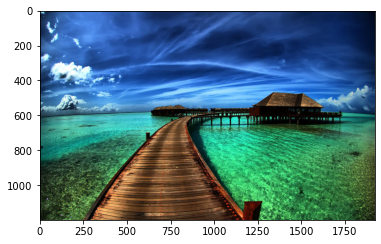

In [7]:
#- 높은 해상도를 가진 이미지를 검색해 저장하고 불러오기

from PIL import Image
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

image = Image.open('high_resolution.jpg')
image = np.array(image)

plt.imshow(image)

In [8]:
print(image.shape)

(1200, 1920, 3)


(300, 480, 3)


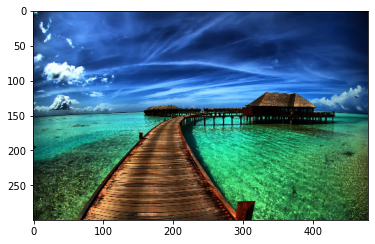

In [9]:
#- 불러온 이미지에 bicubic interpolation을 적용해 가로 * 세로 픽셀 수를 1/4로 줄이기 (cv2.resize())

import cv2

lr_image = cv2.resize(image, dsize=( int(image.shape[1] /4), int(image.shape[0]/4) ))
print(lr_image.shape)

plt.imshow(lr_image)

In [10]:
import tensorflow as tf
import os


model_file = 'srgan_G.h5'
print(model_file)
srgan = tf.keras.models.load_model(model_file)

srgan_G.h5


(1200, 1920, 3)


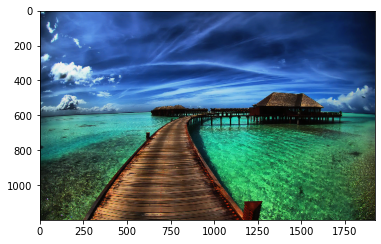

In [11]:
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

srgan_hr = apply_srgan(lr_image)

print(srgan_hr.shape)
plt.imshow(srgan_hr)

(1200, 1920, 3)


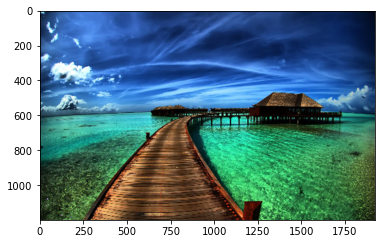

In [12]:
#- 2의 이미지에 bicubic interpolation을 적용해 가로 * 세로 픽셀 수를 다시 4배로 늘리기
bicubic_image = cv2.resize(lr_image, dsize=(image.shape[1], image.shape[0]), interpolation=cv2.INTER_CUBIC)
print(bicubic_image.shape)

plt.imshow(bicubic_image)

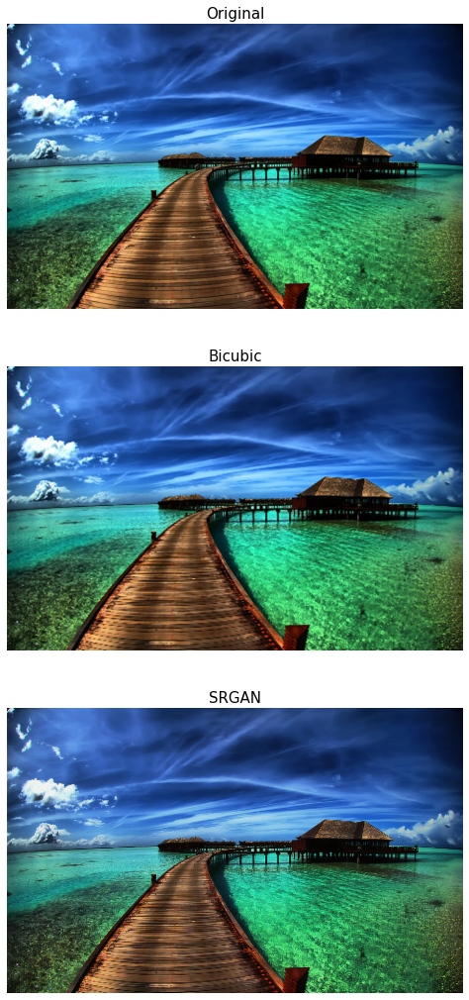

In [13]:
images = [image, bicubic_image, srgan_hr]
labels = ['Original', 'Bicubic', 'SRGAN']

plt.figure(figsize=(18,18))
for i in range(3):
    plt.subplot(3, 1, i+1)
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=15)
    plt.axis('off')

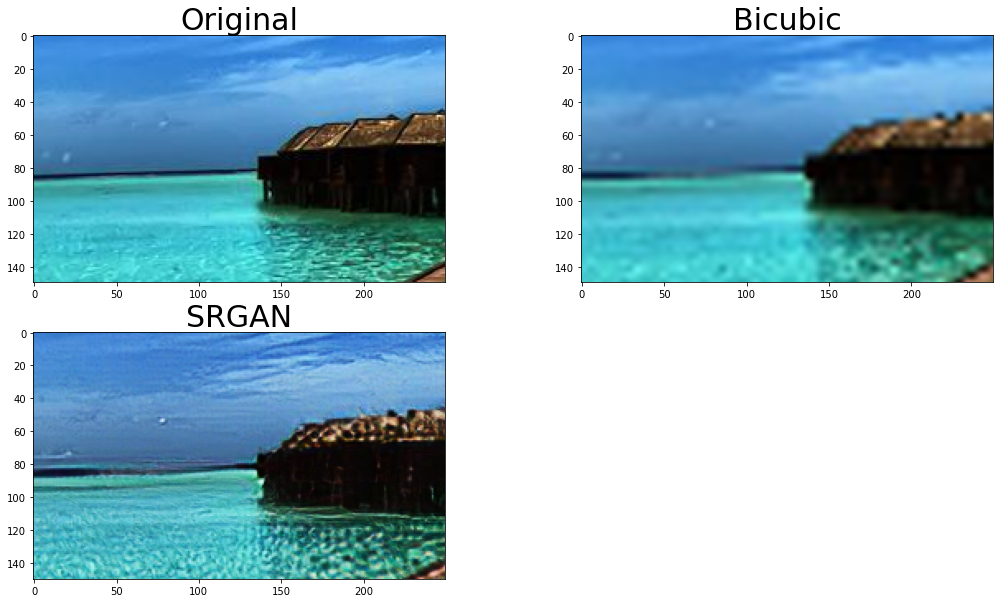

In [14]:
def crop(image, left_top, x = 200, y = 200):
    return image[left_top[0]:(left_top[0] + x), left_top[1]:(left_top[1] + y), :]

left_top = (500, 500)
crop_images = [crop(i, left_top, 150, 250) for i in images]

plt.figure(figsize=(18, 10))

for i in range(3):
    plt.subplot(2, 2, i+1)
    plt.imshow(crop_images[i])
    plt.title(labels[i], fontsize=30)

#### - 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution 했을 때, 어떤 결과가 나왔으며, 왜 이런 결과가 출력되었는지 설명하기


In [15]:

def apply_gen(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = generator.predict(image)
    sr = tf.clip_by_value(sr,0,255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]


gen_hr = apply_gen(lr_image)
print(gen_hr.shape)


(1200, 1920, 3)


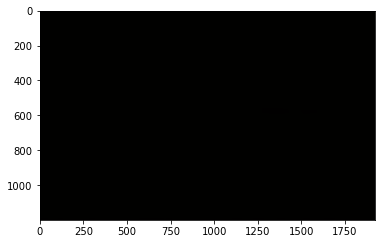

In [16]:
plt.imshow(gen_hr)

### 왜 이런 결과가 출력되었는지 설명하기
###### div2k/bicubic_x4 데이터 한계로 인해 학습 결과 모델로는 인터넷에 있는 임의의 사진에 대해서는  Super Resolution 이  획득 되지 않았음 

----

### 프로젝트 1-2.


1. (적당히) 낮은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.
2. 불러온 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.
3. 1.에서 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. cv2.resize()를 사용해 봅시다.
4. 2개 이미지(3.의 Bicubic의 결과, 2.의 SRGAN의 결과)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.

5. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)


(202, 288, 3)


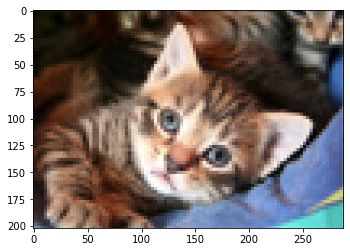

In [17]:
#1. (적당히) 낮은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.

image = Image.open('low_resolution.jpg')
image = np.array(image)

plt.imshow(image)
print(image.shape)

(808, 1152, 3)


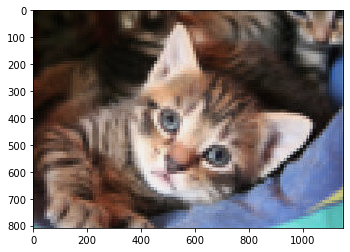

In [18]:
#2. 불러온 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.


srgan_hr = apply_srgan(image)

print(srgan_hr.shape)
plt.imshow(srgan_hr)

(808, 1152, 3)


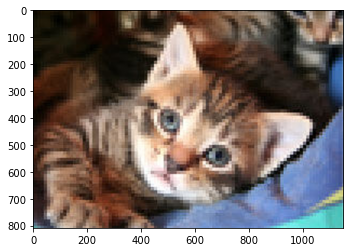

In [19]:
#3. 1.에서 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. cv2.resize()를 사용해 봅시다.

bicubic_image = cv2.resize(image, dsize=(image.shape[1]*4, image.shape[0]*4), interpolation=cv2.INTER_CUBIC)
print(bicubic_image.shape)

plt.imshow(bicubic_image)

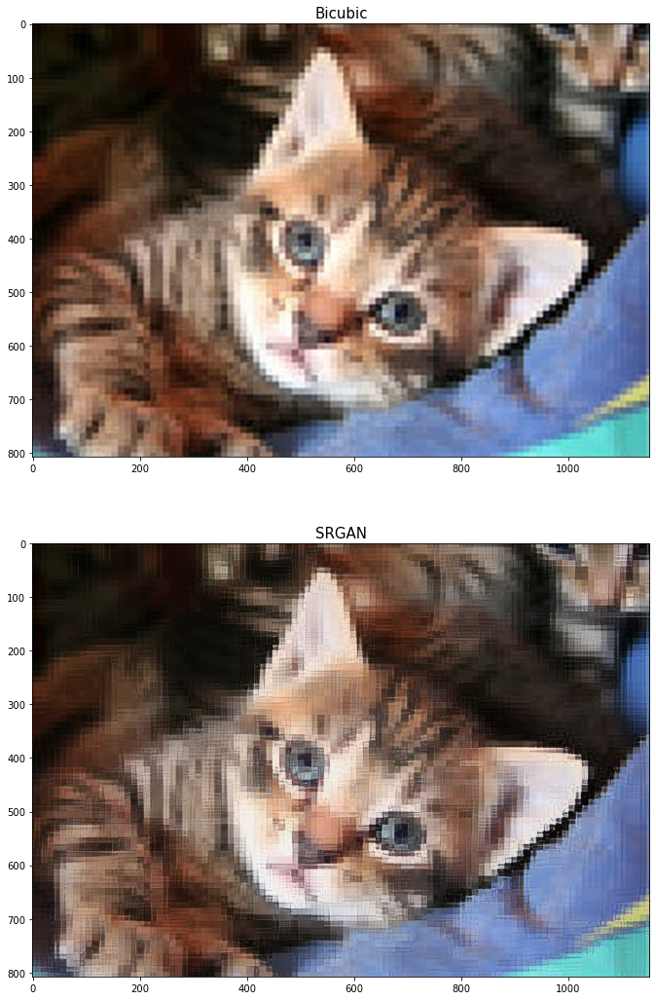

In [20]:
#4. 2개 이미지(3.의 Bicubic의 결과, 2.의 SRGAN의 결과)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.

images = [bicubic_image, srgan_hr]
labels = ['Bicubic', 'SRGAN']

plt.figure(figsize=(18,18))
for i in range(2):
    plt.subplot(2, 1, i+1)
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=15)

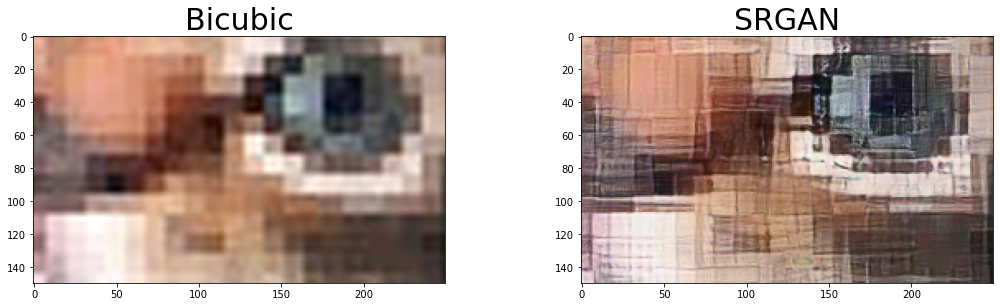

In [21]:
def crop(image, left_top, x = 120, y = 120):
    return image[left_top[0]:(left_top[0] + x), left_top[1]:(left_top[1] + y), :]

left_top = (500, 500)
crop_images = [crop(i, left_top, 150, 250) for i in images]

plt.figure(figsize=(18, 10))

for i in range(2):
    plt.subplot(2, 2, i+1)
    plt.imshow(crop_images[i])
    plt.title(labels[i], fontsize=30)

* 확대를 해 보면 그래도 뭔가 샤프니스 해 졌다는것을 확인 할 수 있음

### 프로젝트 2 : SRGAN을 이용해 고해상도 gif 생성하기
#### 이전 Super Resolution의 활용 사례에 대해 살펴봤을 때, 단일 이미지가 아닌 영상에 대해 Super Resolution을 적용한 사례가 있었습니다. 이번에는 이미 학습된 SRGAN을 이용해 저해상도 영상을 고해상도 영상으로 바꿔보는 프로젝트를 수행해 봅시다.

In [22]:
# 1. gif 파일 불러오기
# https://drive.google.com/drive/folders/1OLsa4btdwNUiVJcOJgZe_C6-lwEoNr4e
gif = cv2.VideoCapture('book_lr.gif')

isTrue = True
frames = []

while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수: ", len(frames))
print("frame 크기: ", (frames[0].shape))
    

frame 수:  22
frame 크기:  (215, 380, 3)


In [23]:
# 2. 프레임 별 SuperResolution 진행하기
frames_sr = []

for frame in frames:
    frames_sr.append(apply_srgan(frame))

In [24]:
# 3. 프레임을 합쳐 gif 만들기
import imageio

imageio.mimsave('book_hr.gif', frames_sr)

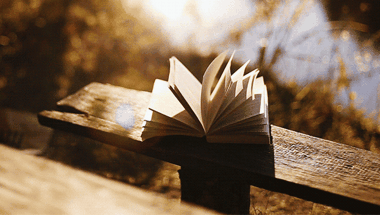

In [25]:
from IPython.display import Image as show_gif

show_gif("book_lr.gif", width=800)



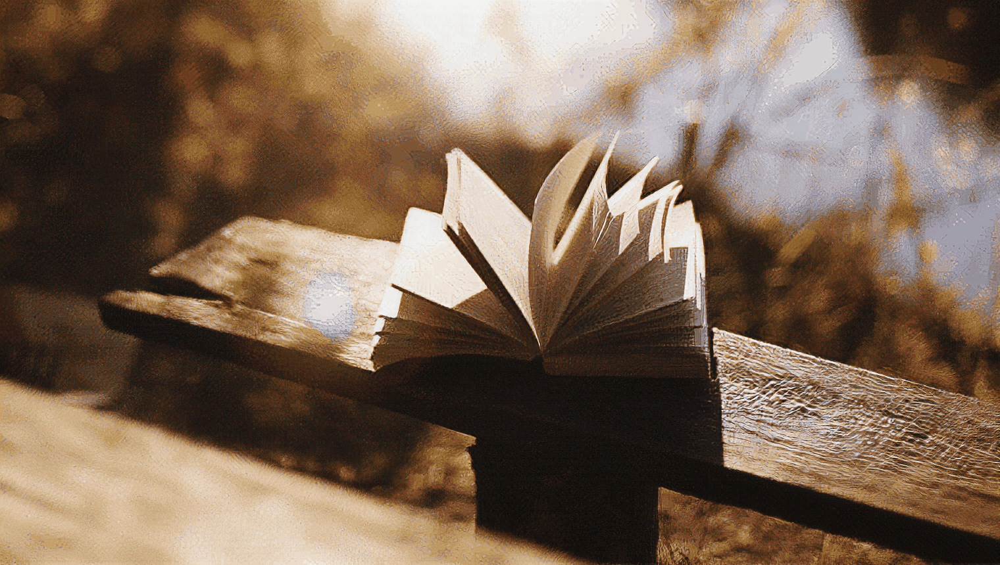

In [26]:
show_gif("book_hr.gif", width=800)

## 루브릭 총평 
1. SRGAN을 이용해 고해상도의 이미지를 생성하였다.
 * SRGAN을 통해 생성된 이미지를 제출하였다.
----
2. 다양한 해상도의 이미지에 대해 시각화를 통해 원본, SRGAN생성본, interpolation생성본을 비교분석하였다.
 * 이미지의 특성과 super resolution 방법을 관련지어 생성 결과를 체계적으로 분석하였다.
----
3. 저해상도 gif 동영상을 고해상도 동영상으로 성공적으로 변환하였다.
 * 저해상도 원본 gif와 생성된 고해상도 gif의 해상도 차이가 시각적으로 확인 가능하다.